In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline 
import folium
from geopy.distance import geodesic
from sklearn.cluster import KMeans

In [2]:
data = pd.read_csv('IndiaPoliticalViolence(no Islands_Kashmir_Ladakh).csv')

In [3]:
data.shape

(36383, 10)

In [4]:
data.head()

,year,month,day,latitude,longitude,fatalities,event_type,sub_event_type,source,notes
0,2016,1,5,17.6800,83.2016,0,Violence against civilians,Abduction/forced disappearance,Chandigarh Tribune,A group of Maoists abduct and shot a TDP: Telu...
1,2016,1,5,17.6800,83.2016,0,Violence against civilians,Abduction/forced disappearance,Chandigarh Tribune,A group of Maoists abduct and shot a TDP: Telu...
2,2019,4,11,16.2349,80.0493,0,Violence against civilians,Abduction/forced disappearance,New Indian Express,"Assumed on 11 Apr, in Narasaraopet tehsil (Gun..."
3,2019,4,11,16.2349,80.0493,0,Violence against civilians,Abduction/forced disappearance,New Indian Express,"Assumed on 11 Apr, in Narasaraopet tehsil (Gun..."
4,2017,1,16,17.8619,82.1970,0,Violence against civilians,Abduction/forced disappearance,South Asia Terrorism Portal,"On 16 January 2017, six tribals were abducted ..."


In [5]:
data.isna().sum()

year              0
month             0
day               0
latitude          0
longitude         0
fatalities        0
event_type        0
sub_event_type    0
source            0
notes             0
dtype: int64

In [6]:
df = data[["latitude", "longitude"]]
df.head()

,latitude,longitude
0,17.6800,83.2016
1,17.6800,83.2016
2,16.2349,80.0493
3,16.2349,80.0493
4,17.8619,82.1970


In [7]:
model = KMeans(n_clusters=4)
y_kmeans = model.fit_predict(df)

In [8]:
y_kmeans

array([1, 1, 1, ..., 2, 2, 2])

In [9]:
df = pd.concat([df, pd.DataFrame(y_kmeans, columns=["y"])], axis=1)
df.head()

,latitude,longitude,y
0,17.6800,83.2016,1
1,17.6800,83.2016,1
2,16.2349,80.0493,1
3,16.2349,80.0493,1
4,17.8619,82.1970,1


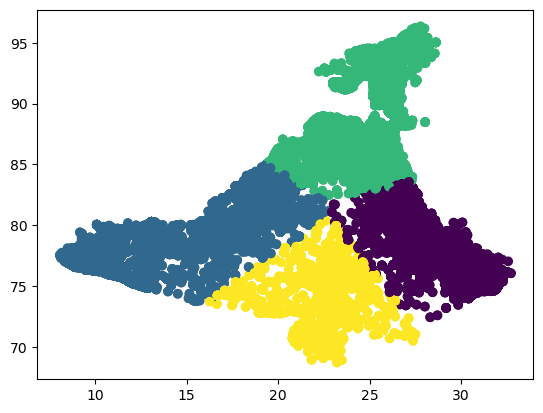

In [10]:
plt.scatter(df['latitude'], df['longitude'], c=df['y'])

In [11]:
model.inertia_

497919.1288557011

In [12]:
wcss = []
for i in range(1,11):
    model = KMeans(n_clusters=i, n_init=10)
    y_kmeans = model.fit_predict(df)
    wcss.append(model.inertia_)

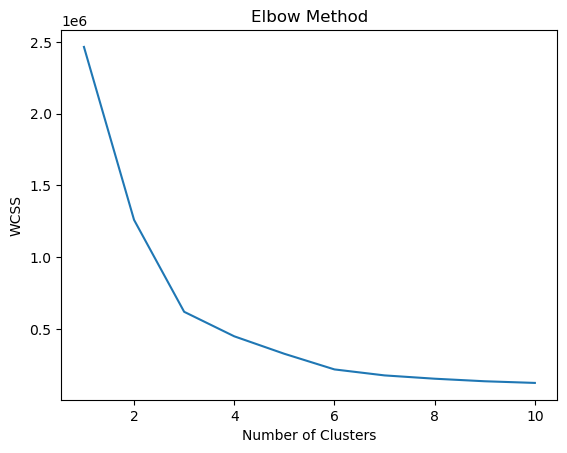

In [13]:
plt.plot(range(1,11), wcss)
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.title('Elbow Method')
plt.show()

In [14]:
cluster1 = df[['latitude','longitude']][df['y']==0].values.tolist()
cluster2 = df[['latitude','longitude']][df['y']==1].values.tolist()
cluster3 = df[['latitude','longitude']][df['y']==2].values.tolist()
cluster4 = df[['latitude','longitude']][df['y']==3].values.tolist()

In [15]:
map = folium.Map(location=[data['latitude'].iloc[0],data['longitude'].iloc[0]], zoom_start = 10, tiles="openstreetmap")
for i in cluster1:
    folium.CircleMarker(i, radius=2, color='blue', fill_color='lightblue').add_to(map)
    
for i in cluster2:
    folium.CircleMarker(i, radius=2, color='red', fill_color='lightred').add_to(map)
    
for i in cluster3:
    folium.CircleMarker(i, radius=2, color='green', fill_color='lightgreen').add_to(map)    
    
for i in cluster4:
    folium.CircleMarker(i, radius=2, color='yellow', fill_color='lightyellow').add_to(map)        

In [16]:
map